<a href="https://colab.research.google.com/github/lmencisoe/CDA/blob/main/Taller3/Talle3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **1.Importación de librerías**

In [1]:
!pip install --upgrade pandas-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 315 kB 4.9 MB/s 
     |████████████████████████████████| 690 kB 37.0 MB/s 
     |████████████████████████████████| 9.9 MB 40.9 MB/s 
     |████████████████████████████████| 102 kB 51.8 MB/s 
     |████████████████████████████████| 62 kB 1.3 MB/s 
     |████████████████████████████████| 4.7 MB 36.1 MB/s 
     |████████████████████████████████| 296 kB 39.1 MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=4877ace9b23499ee86b457c7af4a8c554e8f96e34856cc148c0e589dce78ddd0
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
Successfully built htmlmin
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.12.2
    Uninstalling statsmodels-0.12.2:
      Successfully uninstalled statsmodels-0.12.2
  Attempting uninstall: requests
   

In [2]:
import pandas as pd
import numpy as np
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from pandas_profiling import ProfileReport
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import ConfusionMatrixDisplay, precision_score, recall_score, f1_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
import seaborn as sns
import warnings
import re
warnings.filterwarnings('ignore')

Mounted at /content/drive


**Objetivo:**

1.Predecir desercion laboral basado en la satisfaccion laboral.

2.Definir estrategias para evitar fugas de personal.

Sector: Farmaeutico

Dataset: 1506 rows con 36 columnas




**Diccionario de Datos**

Field - Description

Age - Age of the employee

Attrition - employee attrition

BusinessTravel  -how frequently an employee travels for business purpose

DailyRate Daily - wage of an employee

Department - Employee department

DistanceFromHome - Distance from home to office in KM's

Education - Qualification of employee (masked, higher is better)

EducationField - Stream of Education

EmployeeCount - EmployeeCount

EmployeeNumber - employee number

EnvironmentSatisfaction - Environment (higher is better)

Gender - Gender of employee

HourlyRate - employee hourly rate

JobInvolvement - Job involvement (higher is better)

JobLevel - level of Job (higher is more important)

JobRole - job role of an employee

JobSatisfaction-  if employee is satisfied?

MaritalStatus - employee is married or not

MonthlyIncome - income of an employee

MonthlyRate - monthly rate of an employee

NumCompaniesWorked - number of companies worked for

Over18 - age over 18

OverTime - employee works over time

PercentSalaryHike - salary hike

PerformanceRating - performance rate

RelationshipSatisfaction - Relationship satisfaction

StandardHours - per week standard work hours

StockOptionLevel - company stock option level

TotalWorkingYears - total working years

TrainingTimesLastYear - Training time

WorkLifeBalance - Work life balance

YearsAtCompany - total years at current company

YearsInCurrentRole - total years in current role

YearsSinceLastPromotion - years since last promotion

YearsWithCurrManager - Years worked under current manager

### **1. Limpieza y preparación de datos**

In [231]:
#Abrimos el dataset
#df=pd.read_csv("/content/drive/MyDrive/Taller 3/Data_Taller_3.csv",sep=";")
df=pd.read_csv("/content/drive/MyDrive/Taller3_CDA/Data_Taller_3.csv",sep=";")

In [232]:
df.groupby(['NewEmployee'])['NewEmployee'].count()

NewEmployee
0    1494
1      12
Name: NewEmployee, dtype: int64

In [233]:
#Exploramos los datos inciales
df.head()

,JobSatisfaction,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee
0,4.0,41.0,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,...,80.0,0,8,0,1,6,4,0,5,0
1,2.0,49.0,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,...,80.0,1,10,3,3,10,7,1,7,0
2,3.0,37.0,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,...,80.0,0,7,3,3,0,0,0,0,0
3,3.0,33.0,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,...,80.0,0,8,3,3,8,7,3,0,0
4,2.0,NaN,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,...,80.0,1,6,3,3,2,2,2,2,0


In [234]:
df.shape

(1506, 36)

In [235]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1506 entries, 0 to 1505
Data columns (total 36 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   JobSatisfaction           1494 non-null   float64
 1   Age                       1503 non-null   float64
 2   Attrition                 1505 non-null   object 
 3   BusinessTravel            1506 non-null   object 
 4   DailyRate                 1506 non-null   int64  
 5   Department                1506 non-null   object 
 6   DistanceFromHome          1506 non-null   int64  
 7   Education                 1506 non-null   int64  
 8   EducationField            1506 non-null   object 
 9   EmployeeCount             1506 non-null   int64  
 10  EmployeeNumber            1506 non-null   int64  
 11  EnvironmentSatisfaction   1506 non-null   int64  
 12  Gender                    1506 non-null   object 
 13  HourlyRate                1506 non-null   int64  
 14  JobInvol

In [236]:
# Evidenciamos que la variable JobSatisfaction tiene una  escala de 1 a 4
df.groupby(['JobSatisfaction'])['JobSatisfaction'].count()

JobSatisfaction
1.0    288
2.0    279
3.0    454
4.0    473
Name: JobSatisfaction, dtype: int64

In [237]:
#Se separan de la base los 12 registros con el valor de la variable objetivo "Job Satisfation" nulo para la evaluación del modelo. 
#df_val=df[df['JobSatisfaction'].isna()]
#df=df[df['JobSatisfaction'].isna()==False]
#df['JobSatisfaction']=df['JobSatisfaction'].apply(int)
#df.groupby(['JobSatisfaction'])['JobSatisfaction'].count()

### **1.1 Corrección de formatos y de datos**

#### **1.1.1 Variable Gender** 

In [238]:
# Evidenciamos que la columna Gender tiene valores  no etiquetados correctamente
df.groupby(['Gender'])['Gender'].count()

Gender
Fem       243
Female    261
Male      729
female     95
man       178
Name: Gender, dtype: int64

In [239]:
#limpieza datos columna gender
conditions = [(df['Gender'].str.upper().str.contains('^FEM*')==True),
              (df['Gender'].isin(["man"])==True)
              ]
choices = ['Female','Male']
df['Gender']=np.select(conditions, choices, default=df['Gender'])
df.groupby(['Gender'])['Gender'].count()

Gender
Female    599
Male      907
Name: Gender, dtype: int64

In [240]:
df['Gender'].drop_duplicates()

0    Female
1      Male
Name: Gender, dtype: object

In [241]:
df.shape

(1506, 36)

In [242]:
#Verifiamos si los datos quedaron adecuadamente organizados de la columna Gender
df['Gender']=df['Gender'].apply(str)
df.groupby(['Gender'])['Gender'].count()

Gender
Female    599
Male      907
Name: Gender, dtype: int64

#### **1.1.2 Variable MaritalStatus** 

In [243]:
df.groupby(['MaritalStatus'])['MaritalStatus'].count()

MaritalStatus
D            15
Divorced    322
M            14
Married     671
S            18
Single      466
Name: MaritalStatus, dtype: int64

In [244]:
conditions = [(df['MaritalStatus']=="S"),
              (df['MaritalStatus']=="M"),
              (df['MaritalStatus']=="D"),
              ]
choices = ['Single','Married','Divorced']
df['MaritalStatus']=np.select(conditions, choices, default=df['MaritalStatus'])

In [245]:
#Verifica Datos limpios 
df['MaritalStatus']=df['MaritalStatus'].apply(str)
df.groupby(['MaritalStatus'])['MaritalStatus'].count()

MaritalStatus
Divorced    337
Married     685
Single      484
Name: MaritalStatus, dtype: int64

#### **1.1.3 Variable Age** 


In [246]:
df.groupby(['Age'])['Age'].count()

Age
3.0       2
18.0      8
19.0      8
20.0     11
21.0     13
22.0     16
23.0     15
24.0     26
25.0     28
26.0     39
27.0     50
28.0     50
29.0     68
30.0     62
31.0     71
32.0     63
33.0     59
34.0     76
35.0     81
36.0     70
37.0     51
38.0     60
39.0     43
40.0     57
41.0     40
42.0     48
43.0     32
44.0     34
45.0     43
46.0     33
47.0     24
48.0     19
49.0     25
50.0     30
51.0     20
52.0     19
53.0     19
54.0     18
55.0     23
56.0     14
57.0      4
58.0     14
59.0     10
60.0      5
190.0     1
200.0     1
Name: Age, dtype: int64

In [247]:
#Ajutamos valores atipicos y tipo de datos
df['Age'] = df['Age'].replace('190.0','190')
df['Age'] = df['Age'].replace('200.0','200')
df['Age'] = df['Age'].replace(3,18)
df['Age'] = df['Age'].replace(190,60)
df['Age'] = df['Age'].replace(200,60)
df['Age'][df['Age'].isna()]=df['TotalWorkingYears']+18
df.groupby(['Age'])['Age'].count()

Age
18.0    10
19.0     8
20.0    11
21.0    13
22.0    16
23.0    16
24.0    27
25.0    28
26.0    39
27.0    50
28.0    51
29.0    68
30.0    62
31.0    71
32.0    63
33.0    59
34.0    76
35.0    81
36.0    70
37.0    51
38.0    60
39.0    43
40.0    57
41.0    40
42.0    48
43.0    32
44.0    34
45.0    43
46.0    33
47.0    24
48.0    19
49.0    25
50.0    30
51.0    20
52.0    19
53.0    19
54.0    18
55.0    23
56.0    14
57.0     4
58.0    14
59.0    10
60.0     7
Name: Age, dtype: int64

#### **1.1.4 Variable Attrion** 

In [248]:
df.groupby(['Attrition'])['Attrition'].count()

Attrition
Na        5
No     1254
Yes     246
Name: Attrition, dtype: int64

In [250]:
conditions = [(df['Attrition'].str.upper().str.contains('^NA*')==True),
              (df['Attrition'].isin(["Na","nan"])==True)
              ]
choices = ['No','No']
df['Attrition']=np.select(conditions, choices, default=df['Attrition'])
df['Attrition']=df['Attrition'].apply(str)
df.groupby(['Attrition'])['Attrition'].count()

Attrition
No     1260
Yes     246
Name: Attrition, dtype: int64

#### **1.1.4 Variable BusinessTravel** 

In [251]:
#Exploracion datos de la columna BussinessTravel
df.groupby(['BusinessTravel'])['BusinessTravel'].count()

BusinessTravel
Non-Travel            154
Travel_Frequently     283
Travel_Rarely        1069
Name: BusinessTravel, dtype: int64

In [252]:
df['BusinessTravel'] = df['BusinessTravel'].replace('Non-Travel','Travel_No')
df['BusinessTravel']=df['BusinessTravel'].apply(str)
df.groupby(['BusinessTravel'])['BusinessTravel'].count()

BusinessTravel
Travel_Frequently     283
Travel_No             154
Travel_Rarely        1069
Name: BusinessTravel, dtype: int64

#### **1.1.4 Variable DailyRate Daily** 

In [253]:
#Exploracion datos de la columna DailyRate
df['DailyRate']=df['DailyRate'].apply(int)
df.groupby(['DailyRate'])['DailyRate'].count()

DailyRate
102     1
103     2
104     1
105     1
106     1
       ..
1492    1
1495    3
1496    2
1498    1
1499    1
Name: DailyRate, Length: 886, dtype: int64

#### **1.1.4 Variable Department** 

In [254]:
#Exploracion datos de la columna DailyRate
df['DailyRate']=df['DailyRate'].apply(str)
df.groupby(['Department'])['Department'].count()

Department
Human Resources            63
Research & Development    989
Sales                     454
Name: Department, dtype: int64

#### **1.1.4 Variable DistanceFromHome** 

In [255]:
df['DistanceFromHome']=df['DistanceFromHome'].apply(int)
df.groupby(['DistanceFromHome'])['DistanceFromHome'].count()

DistanceFromHome
1     213
2     213
3      90
4      65
5      66
6      62
7      84
8      81
9      86
10     87
11     30
12     21
13     19
14     21
15     27
16     34
17     21
18     26
19     23
20     26
21     18
22     19
23     28
24     29
25     27
26     26
27     13
28     23
29     28
Name: DistanceFromHome, dtype: int64

Se revisa sin existen datos por encima de tres desviaciones estandar del promedio.

In [256]:
df[df['DistanceFromHome'] > (df['DistanceFromHome'].mean() + df['DistanceFromHome'].std() * 3)].shape

(0, 36)

#### **1.1.4 Variable Education** 

In [257]:
df['Education']=df['Education'].apply(int)
df.groupby(['Education'])['Education'].count()

Education
1    171
2    295
3    585
4    404
5     49
7      2
Name: Education, dtype: int64

El nivel de educación 7 se reemplazará por el nuivel de educación 5

In [258]:
df['Education'] = df['Education'].replace(7,5)

#### **1.1.4 Variable EducationField** 

In [259]:
df.groupby(['EducationField'])['EducationField'].count()

EducationField
Human Resources      27
Life Sciences       619
Marketing           161
Med                 118
Medical             357
Other                88
Technical Degree    136
Name: EducationField, dtype: int64

In [260]:
df['EducationField'] = df['EducationField'].replace('Med','Medical')

In [261]:
df.groupby(['EducationField'])['EducationField'].count()

EducationField
Human Resources      27
Life Sciences       619
Marketing           161
Medical             475
Other                88
Technical Degree    136
Name: EducationField, dtype: int64

#### **1.1.4 Variable EmployeeCount** 

In [262]:
df.groupby(['EmployeeCount'])['EmployeeCount'].count()
df['EmployeeCount'] = df['EmployeeCount'].replace(2,1)
df['EmployeeCount']=df['EmployeeCount'].apply(int)

In [263]:
#Verificamos datos ordenados correctamente
df.groupby(['EmployeeCount'])['EmployeeCount'].count()

EmployeeCount
1    1506
Name: EmployeeCount, dtype: int64

In [264]:
del df['EmployeeCount']

#### **1.1.4 Variable EmployeeNumber** 

In [265]:
#Exploramos los datos 
df['EmployeeNumber']=df['EmployeeNumber'].apply(int)
df.groupby(['EmployeeNumber'])['EmployeeNumber'].count()
del df['EmployeeNumber']

#### **1.1.4 Variable EnvironmentSatisfaction** 

In [266]:
#Exploramos los datos 
df['EnvironmentSatisfaction']=df['EnvironmentSatisfaction'].apply(int)
df.groupby(['EnvironmentSatisfaction'])['EnvironmentSatisfaction'].count()

EnvironmentSatisfaction
1    288
2    294
3    462
4    462
Name: EnvironmentSatisfaction, dtype: int64

#### **1.1.4 Variable HourlyRate** 

In [267]:
#Exploramos los datos 
df['HourlyRate']=df['HourlyRate'].apply(int)
df.groupby(['HourlyRate'])['HourlyRate'].count()

HourlyRate
30     19
31     16
32     24
33     19
34     12
       ..
150     1
169     1
179     1
186     1
190     1
Name: HourlyRate, Length: 76, dtype: int64

In [268]:
df[df['HourlyRate'] > (df['HourlyRate'].mean() + df['HourlyRate'].std() * 3)]
Q1 = df['HourlyRate'].quantile(0.25)
Q3 = df['HourlyRate'].quantile(0.75)
IQR = Q3 - Q1
df['HourlyRate'][df['HourlyRate'] > (df['HourlyRate'].mean() + df['HourlyRate'].std() * 3)]=Q3+(1.5*IQR)

#### **1.1.4 Variable JobInvolvement** 

In [269]:
#Exploramos los datos 
df['JobInvolvement']=df['JobInvolvement'].apply(int)
df.groupby(['JobInvolvement'])['JobInvolvement'].count()

JobInvolvement
1     87
2    386
3    881
4    152
Name: JobInvolvement, dtype: int64

#### **1.1.4 Variable JobLevel** 

In [270]:
#Exploramos los datos 
df['JobLevel']=df['JobLevel'].apply(int)
df.groupby(['JobLevel'])['JobLevel'].count()

JobLevel
1    564
2    543
3    221
4    108
5     70
Name: JobLevel, dtype: int64

#### **1.1.4 Variable JobRole** 

In [271]:
#Exploramos los datos 

df['JobRole']=df['JobRole'].apply(str)
df['JobRole'] = df['JobRole'].replace('RH','Human Resources')
df.groupby(['JobRole'])['JobRole'].count()

JobRole
Healthcare Representative    134
Human Resources               52
Lab Tech                     150
Laboratory Technician        122
Manager                      104
Manufacturing Director       148
Research Director             80
Research Scientist           300
Sales Executive              330
Sales Representative          86
Name: JobRole, dtype: int64

#### **1.1.4 Variable JobSatisfaction** 

In [272]:
#df['JobSatisfaction']=df['JobSatisfaction'].apply(int)
#df.groupby(['JobSatisfaction'])['JobSatisfaction'].count()

#### **1.1.4 Variable MonthlyIncome** 

In [273]:
# Explora datos y ajusta tipo de dato
df['MonthlyIncome']=df['MonthlyIncome'].apply(float)
df.groupby(['MonthlyIncome'])['MonthlyIncome'].count()

MonthlyIncome
25.0         1
50.0         1
1009.0       1
1051.0       1
1052.0       1
            ..
19926.0      1
19943.0      1
19973.0      1
19999.0      1
9907000.0    1
Name: MonthlyIncome, Length: 1349, dtype: int64

Se identifica un valor atípico, y es reemplazado por el máximo de los valores típicos

In [274]:
Q1 = df['MonthlyIncome'].quantile(0.25)
Q3 = df['MonthlyIncome'].quantile(0.75)
IQR = Q3 - Q1
df['MonthlyIncome'][df['MonthlyIncome'] > (df['MonthlyIncome'].mean() + df['MonthlyIncome'].std() * 3)]=Q3+(1.5*IQR)

#### **1.1.4 Variable MonthlyRate** 

In [275]:
df['MonthlyRate']=df['MonthlyRate'].apply(int)
df.groupby(['MonthlyRate'])['MonthlyRate'].count()

MonthlyRate
2094     2
2097     1
2104     1
2112     1
2122     1
        ..
26956    1
26959    1
26968    1
26997    1
26999    1
Name: MonthlyRate, Length: 1427, dtype: int64

In [276]:
df[df['MonthlyRate'] > (df['MonthlyRate'].mean() + df['MonthlyRate'].std() * 3)].shape

(0, 34)

No se identifican valores atípicos para esta variable

#### **1.1.4 Variable NumCompaniesWorked** 

In [277]:
#Exploramos datos 
#Numero de compañias en las que ha trabajado en el pasado - Equivale de cierta manera a la experiencia acumulada del empleado
df['NumCompaniesWorked']=df['NumCompaniesWorked'].apply(int)
df.groupby(['NumCompaniesWorked'])['NumCompaniesWorked'].count()

NumCompaniesWorked
0    200
1    535
2    152
3    164
4    144
5     63
6     72
7     74
8     50
9     52
Name: NumCompaniesWorked, dtype: int64

#### **1.1.4 Variable Over18** 

In [278]:
# Explora datos variable mas 18 años 
df['Over18']=df['Over18'].apply(str)
df.groupby(['Over18'])['Over18'].count()
 # Se evidencia que el 100%  de los empleados tienen  mas de 18 años. Esta variable se debe descartar en el  modelo ya que no influye en los resultados. Por ley todo los empleados deben ser mayores de 18 años. 

Over18
Y    1506
Name: Over18, dtype: int64

In [279]:
del df['Over18']

#### **1.1.4 Variable OverTime** 

In [280]:
df.groupby(['OverTime'])['OverTime'].count()
#Se reliza el ajuste de Na asumiendo que de los 137 que no tienen informacion significa que no hicieron overtime

OverTime
Na     137
No     941
Yes    428
Name: OverTime, dtype: int64

In [281]:
df['OverTime'] = df['OverTime'].replace('Na','No')

In [282]:
# Resultado datos limpios 
df.groupby(['OverTime'])['OverTime'].count()

OverTime
No     1078
Yes     428
Name: OverTime, dtype: int64

#### **1.1.4 Variable PercentSalaryHike** 

In [283]:
# Exploramos datos - % porcentaje de aumento en el salario
df['PercentSalaryHike']=df['PercentSalaryHike'].apply(int)
df.groupby(['PercentSalaryHike'])['PercentSalaryHike'].count()

PercentSalaryHike
11    217
12    203
13    215
14    206
15    104
16     80
17     84
18     91
19     76
20     55
21     49
22     57
23     30
24     21
25     18
Name: PercentSalaryHike, dtype: int64

In [284]:
df[df['PercentSalaryHike'] > (df['PercentSalaryHike'].mean() + df['PercentSalaryHike'].std() * 3)].shape

(0, 33)

Para esta variable no exiten valor atípicos

#### **1.1.4 Variable PerformanceRating** 

In [285]:
# Exploramos datos - Performance 
df['PerformanceRating']=df['PerformanceRating'].apply(int)
df.groupby(['PerformanceRating'])['PerformanceRating'].count()

PerformanceRating
3    1276
4     230
Name: PerformanceRating, dtype: int64

#### **1.1.4 Variable RelationshipSatisfaction** 

In [286]:
# Exploramos datos 
df['RelationshipSatisfaction']=df['RelationshipSatisfaction'].apply(int)
df.groupby(['RelationshipSatisfaction'])['RelationshipSatisfaction'].count()

RelationshipSatisfaction
1    282
2    312
3    469
4    443
Name: RelationshipSatisfaction, dtype: int64

#### **1.1.4 Variable StandardHours** 

In [288]:
#df=df[df['StandardHours'].isna()==False]
#df['StandardHours']=df['StandardHours'].apply(int)
df.groupby(['StandardHours'])['StandardHours'].count()

StandardHours
80.0    1499
Name: StandardHours, dtype: int64

In [290]:
del df['StandardHours']

KeyError: ignored

#### **1.1.4 Variable StockOptionLevel** 

In [291]:
# Exploramos datos 
df['StockOptionLevel']=df['StockOptionLevel'].apply(int)
df.groupby(['StockOptionLevel'])['StockOptionLevel'].count()

StockOptionLevel
0    650
1    608
2    162
3     86
Name: StockOptionLevel, dtype: int64

#### **1.1.4 Variable TotalWorkingYears** 

In [292]:
df['TotalWorkingYears']=df['TotalWorkingYears'].apply(int)
df.groupby(['TotalWorkingYears'])['TotalWorkingYears'].count()

TotalWorkingYears
0      12
1      85
2      32
3      44
4      63
5      91
6     130
7      85
8     106
9      99
10    205
11     36
12     49
13     36
14     31
15     40
16     37
17     34
18     27
19     23
20     30
21     34
22     22
23     22
24     19
25     14
26     15
27      7
28     14
29     10
30      7
31     10
32      9
33      7
34      5
35      3
36      6
37      4
38      1
40      2
Name: TotalWorkingYears, dtype: int64

Se identifican valores atíícospi

In [293]:
df[df['TotalWorkingYears'] > (df['TotalWorkingYears'].mean() + df['TotalWorkingYears'].std() * 3)].shape

(16, 32)

In [294]:
Q1 = df['TotalWorkingYears'].quantile(0.25)
Q3 = df['TotalWorkingYears'].quantile(0.75)
IQR = Q3 - Q1
df['TotalWorkingYears'][df['TotalWorkingYears'] > (df['TotalWorkingYears'].mean() + df['TotalWorkingYears'].std() * 3)]=Q3+(1.5*IQR)

#### **1.1.4 Variable TrainingTimesLastYear** 

In [295]:
df['TrainingTimesLastYear']=df['TrainingTimesLastYear'].apply(int)
df.groupby(['TrainingTimesLastYear'])['TrainingTimesLastYear'].count()

TrainingTimesLastYear
0     56
1     72
2    558
3    505
4    125
5    122
6     68
Name: TrainingTimesLastYear, dtype: int64

#### **1.1.4 Variable WorkLifeBalance** 

In [296]:
#Explora datos
df['WorkLifeBalance']=df['WorkLifeBalance'].apply(int)
df.groupby(['WorkLifeBalance'])['WorkLifeBalance'].count()

WorkLifeBalance
1     82
2    354
3    915
4    155
Name: WorkLifeBalance, dtype: int64

#### **1.1.4 Variable YearsAtCompany** 

In [297]:
#Explora datos
df['YearsAtCompany']=df['YearsAtCompany'].apply(int)
np.where(df['YearsAtCompany']==100,df['Age'][df['YearsAtCompany']==100]-18,df['YearsAtCompany'])
df.groupby(['YearsAtCompany'])['YearsAtCompany'].count()

YearsAtCompany
0       46
1      178
2      130
3      130
4      113
5      200
6       77
7       94
8       81
9       86
10     120
11      32
12      15
13      24
14      19
15      20
16      12
17       9
18      13
19      11
20      27
21      14
22      16
23       2
24       6
25       5
26       4
27       2
29       2
30       1
31       3
32       3
33       5
34       1
36       2
37       1
40       1
100      1
Name: YearsAtCompany, dtype: int64

#### **1.1.4 Variable YearsInCurrentRole** 

In [298]:
#Explora Datos
df['YearsInCurrentRole']=df['YearsInCurrentRole'].apply(int)
df.groupby(['YearsInCurrentRole'])['YearsInCurrentRole'].count()

YearsInCurrentRole
0     254
1      58
2     381
3     137
4     105
5      37
6      38
7     228
8      93
9      67
10     29
11     22
12     10
13     15
14     11
15      8
16      7
17      4
18      2
Name: YearsInCurrentRole, dtype: int64

#### **1.1.4 Variable YearsSinceLastPromotion** 

In [299]:
#Explora Datos
df['YearsSinceLastPromotion']=df['YearsSinceLastPromotion'].apply(int)
df.groupby(['YearsSinceLastPromotion'])['YearsSinceLastPromotion'].count()

YearsSinceLastPromotion
0     595
1     366
2     163
3      57
4      63
5      46
6      32
7      77
8      18
9      17
10      6
11     24
12     10
13     10
14      9
15     13
Name: YearsSinceLastPromotion, dtype: int64

#### **1.1.4 Variable YearsWithCurrManager** 

In [300]:
df.groupby(['NewEmployee'])['NewEmployee'].count()

NewEmployee
0    1494
1      12
Name: NewEmployee, dtype: int64

In [301]:
df.shape

(1506, 32)

In [302]:
#del df['NewEmployee']

In [303]:
#Explora Datos
df['YearsWithCurrManager']=df['YearsWithCurrManager'].apply(int)
df.groupby(['YearsWithCurrManager'])['YearsWithCurrManager'].count()

YearsWithCurrManager
0     274
1      77
2     348
3     148
4      99
5      32
6      30
7     222
8     111
9      64
10     27
11     22
12     18
13     14
14      5
15      5
16      2
17      8
Name: YearsWithCurrManager, dtype: int64

In [304]:
df.isna().sum()

JobSatisfaction             12
Age                          0
Attrition                    0
BusinessTravel               0
DailyRate                    0
Department                   0
DistanceFromHome             0
Education                    0
EducationField               0
EnvironmentSatisfaction      0
Gender                       0
HourlyRate                   0
JobInvolvement               0
JobLevel                     0
JobRole                      0
MaritalStatus                0
MonthlyIncome                0
MonthlyRate                  0
NumCompaniesWorked           0
OverTime                     0
PercentSalaryHike            0
PerformanceRating            0
RelationshipSatisfaction     0
StockOptionLevel             0
TotalWorkingYears            0
TrainingTimesLastYear        0
WorkLifeBalance              0
YearsAtCompany               0
YearsInCurrentRole           0
YearsSinceLastPromotion      0
YearsWithCurrManager         0
NewEmployee                  0
dtype: i

### **2. Analisis Datos**

In [305]:
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **Después del profiling se eliminan las variables altamente correlacionadas**
Age con JobLevel, MonthlyIncome y TotalWorkingYears (se deja Age) \\
Department con EducationField y JobRole (se deja EducationField) \\
MaritalStatus con StockOptionLevel (se deja MaritalStatus) \\
MonthlyIncome con Age, JobLevel, JobRole, TotalWorkingYears, YearsAtCompany, YearsinCurrentRole (ya se eliminó esta, se dejó Age.) \\
PercentSalaryHike con PerformanceRating (se deja PercentSalaryHike) \\
YearsSinceLastPromotion con YearsWithCurrManager (se deja YearsSinceLastPromotion) \\

In [321]:
df_limpia = df.copy()

In [322]:
df_limpia = df_limpia.drop(columns=['JobLevel', 
                                        'TotalWorkingYears', 
                                        'EducationField',
                                        'JobRole',
                                        'StockOptionLevel',
                                        'YearsAtCompany', 
                                        'YearsInCurrentRole', 
                                        'PerformanceRating',
                                        'YearsWithCurrManager'])

In [309]:
df_limpia.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

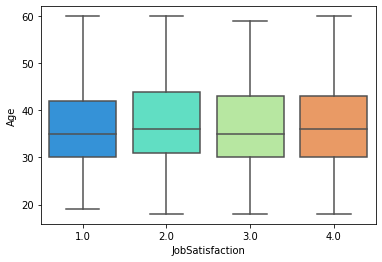

In [323]:
sns.boxplot(x='JobSatisfaction',y='Age',data=df_limpia, palette='rainbow')

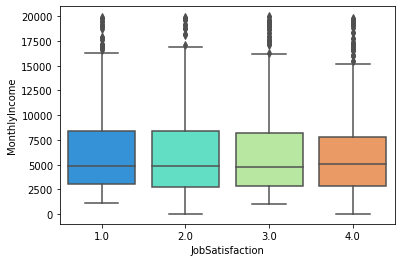

In [324]:
sns.boxplot(x='JobSatisfaction',y='MonthlyIncome',data=df_limpia, palette='rainbow')

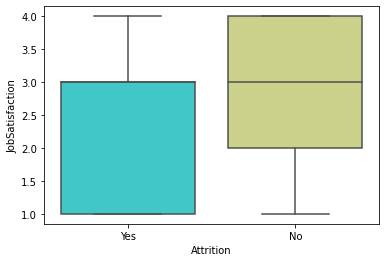

In [325]:
sns.boxplot(x='Attrition',y='JobSatisfaction',data=df_limpia, palette='rainbow')

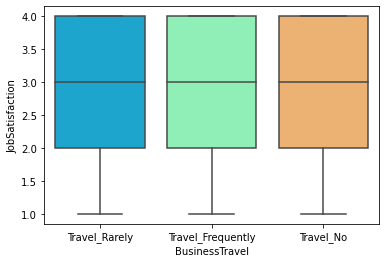

In [326]:
sns.boxplot(x='BusinessTravel',y='JobSatisfaction',data=df_limpia, palette='rainbow')

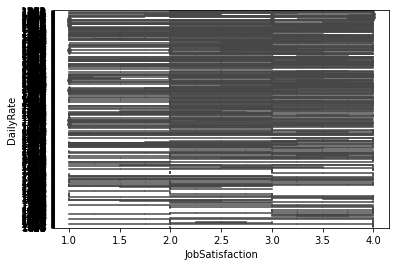

In [327]:
sns.boxplot(x='JobSatisfaction',y='DailyRate',data=df_limpia, palette='rainbow')

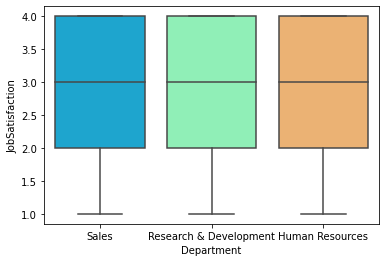

In [328]:
sns.boxplot(x='Department',y='JobSatisfaction',data=df_limpia, palette='rainbow')

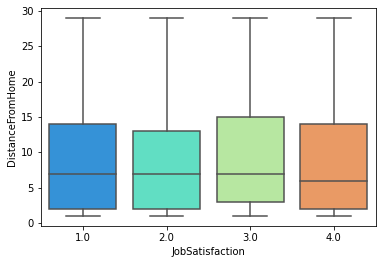

In [329]:
#DistanceFromHome
sns.boxplot(x='JobSatisfaction',y='DistanceFromHome',data=df_limpia, palette='rainbow')

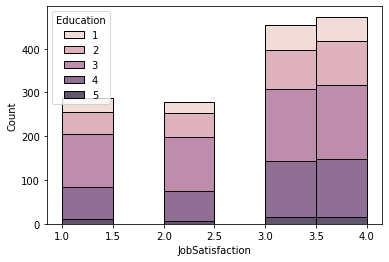

In [330]:
sns.histplot(binwidth=0.5, x="JobSatisfaction", hue="Education", data=df_limpia, stat="count", multiple="stack")

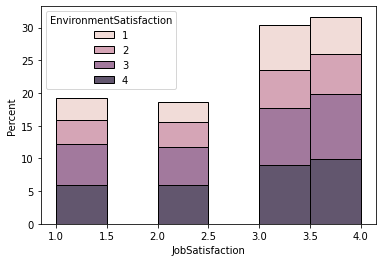

In [335]:
#EnvironmentSatisfaction
sns.histplot(binwidth=0.5, x="JobSatisfaction", hue="EnvironmentSatisfaction", data=df_limpia, stat="percent", multiple="stack")

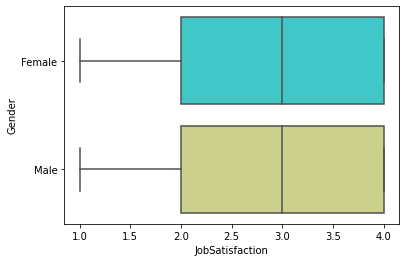

In [336]:
#Gender
sns.boxplot(x='JobSatisfaction',y='Gender',data=df_limpia, palette='rainbow')

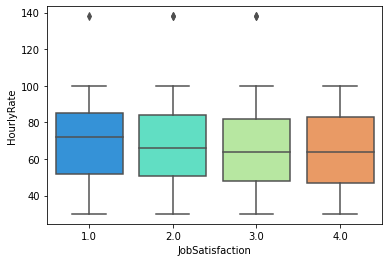

In [337]:
#HourlyRate
sns.boxplot(x='JobSatisfaction',y='HourlyRate',data=df_limpia, palette='rainbow')

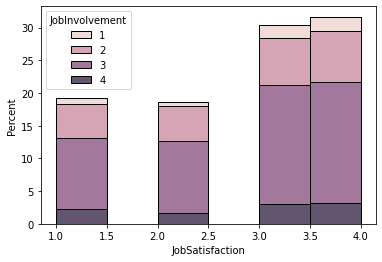

In [338]:
#JobInvolvement
sns.histplot(binwidth=0.5, x="JobSatisfaction", hue="JobInvolvement", data=df_limpia, stat="percent", multiple="stack")

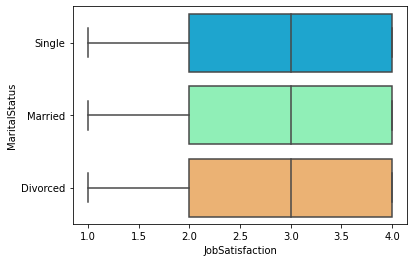

In [345]:
#MaritalStatus
sns.boxplot(x='JobSatisfaction',y='MaritalStatus',data=df_limpia, palette='rainbow')

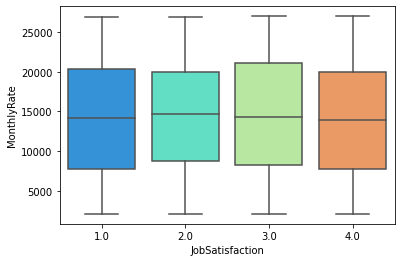

In [346]:
#MonthlyRate
sns.boxplot(x='JobSatisfaction',y='MonthlyRate',data=df_limpia, palette='rainbow')

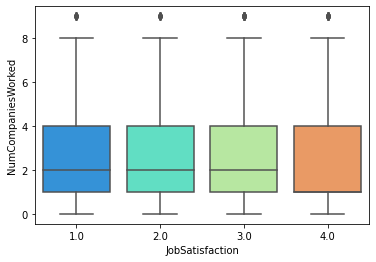

In [347]:
#NumCompaniesWorked
sns.boxplot(x='JobSatisfaction',y='NumCompaniesWorked',data=df_limpia, palette='rainbow')

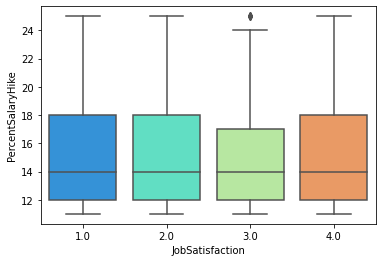

In [348]:
#PercentSalaryHike
sns.boxplot(x='JobSatisfaction',y='PercentSalaryHike',data=df_limpia, palette='rainbow')

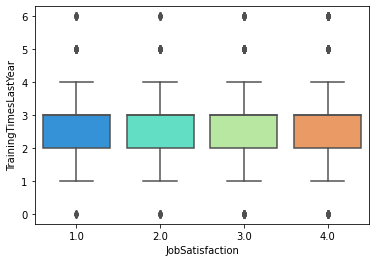

In [349]:
#TrainingTimesLastYear
sns.boxplot(x='JobSatisfaction',y='TrainingTimesLastYear',data=df_limpia, palette='rainbow')

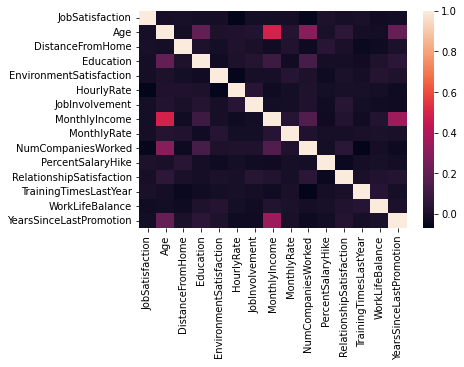

In [352]:
sns.heatmap(df_limpia[['JobSatisfaction','Age','DistanceFromHome', 'Education','EnvironmentSatisfaction', 'HourlyRate','JobInvolvement','MonthlyIncome', 'MonthlyRate','NumCompaniesWorked', 'PercentSalaryHike','RelationshipSatisfaction', 'TrainingTimesLastYear', 'WorkLifeBalance','YearsSinceLastPromotion']].corr())

Se identifca una alta correlación entre algunas variables como por ejemplo el salario y mensual y el Nivel laboral, adiconalmente las variables relacionadas con los años como los años de antiguedad, años de la última promoción, por lo cual contempla alguna tecnica de reducción de dimensionalidad.

### **3.1.Codificación y Normalización de datos**

In [353]:
df_limpia.head()

,JobSatisfaction,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,...,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,RelationshipSatisfaction,TrainingTimesLastYear,WorkLifeBalance,YearsSinceLastPromotion,NewEmployee
0,4.0,41.0,Yes,Travel_Rarely,1102,Sales,1,2,2,Female,...,5993.0,19479,8,Yes,11,1,0,1,0,0
1,2.0,49.0,No,Travel_Frequently,279,Research & Development,8,1,3,Male,...,5130.0,24907,1,No,23,4,3,3,1,0
2,3.0,37.0,Yes,Travel_Rarely,1373,Research & Development,2,2,4,Male,...,2090.0,2396,6,Yes,15,2,3,3,0,0
3,3.0,33.0,No,Travel_Frequently,1392,Research & Development,3,4,4,Female,...,2909.0,23159,1,Yes,11,3,3,3,3,0
4,2.0,24.0,No,Travel_Rarely,591,Research & Development,2,1,1,Male,...,3468.0,16632,9,No,12,4,3,3,2,0


In [354]:
base_modelo = df_limpia.copy()

In [357]:
base_modelo[['Age', 'DailyRate', 'DistanceFromHome', 
'HourlyRate', 'MonthlyIncome', 
'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
'TrainingTimesLastYear', 
'YearsSinceLastPromotion']] = StandardScaler().fit_transform(base_modelo[['Age', 'DailyRate', 'DistanceFromHome', 
'HourlyRate', 'MonthlyIncome', 
'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
'TrainingTimesLastYear',
'YearsSinceLastPromotion']])

In [363]:
dummies_1 = pd.get_dummies(base_modelo['BusinessTravel'], prefix='BusinessTravel_g_').reset_index(drop=True)
dummies_2 = pd.get_dummies(base_modelo['Department'], prefix='Department_g_').reset_index(drop=True)
dummies_3 = pd.get_dummies(base_modelo['Education'], prefix='Education_g_').reset_index(drop=True)
dummies_4 = pd.get_dummies(base_modelo['EnvironmentSatisfaction'], prefix='EnvironmentSatisfaction_g_').reset_index(drop=True)
dummies_5 = pd.get_dummies(base_modelo['Gender'], prefix='Gender_g_').reset_index(drop=True)
dummies_6 = pd.get_dummies(base_modelo['JobInvolvement'], prefix='JobInvolvement_g_').reset_index(drop=True)
dummies_7 = pd.get_dummies(base_modelo['MaritalStatus'], prefix='MaritalStatus_g_').reset_index(drop=True)
dummies_8 = pd.get_dummies(base_modelo['RelationshipSatisfaction'], prefix='RelationshipSatisfaction_g_').reset_index(drop=True)
dummies_9 = pd.get_dummies(base_modelo['WorkLifeBalance'], prefix='WorkLifeBalance_g_').reset_index(drop=True)

In [364]:
base_modelo = base_modelo.drop(columns=['BusinessTravel',
                                        'Department', 
                                        'Education',
                                        'EnvironmentSatisfaction',
                                        'Gender',
                                        'JobInvolvement',
                                        'MaritalStatus',
                                        'RelationshipSatisfaction',
                                        'WorkLifeBalance'])

In [365]:
base_modelo2 = base_modelo.copy()

In [366]:
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_1], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_2], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_3], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_4], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_5], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_6], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_7], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_8], axis=1)
base_modelo2 = pd.concat([base_modelo2.reset_index(drop=True), dummies_9], axis=1)

In [367]:
base_modelo2 = pd.DataFrame(base_modelo2)

In [377]:
base_modelo3 = base_modelo2.copy()
base_modelo3.shape

(1506, 46)

In [378]:
base_modelo3 = base_modelo3[base_modelo3['NewEmployee']==0]
base_new_e = base_modelo3[base_modelo3['NewEmployee']==1]
base_modelo3.shape

(1494, 46)

In [379]:
base_modelo3 = base_modelo3.drop(columns=['NewEmployee'])

In [380]:
base_modelo3.to_csv("/content/drive/MyDrive/Taller3_CDA/Data_Taller_3_modelo.csv",sep=";",index=False)
base_new_e.to_csv("/content/drive/MyDrive/Taller3_CDA/Data_Taller_3_new_e.csv",sep=";",index=False)